**NOTE: THE CODE WORKS BY CHANGING THE RUNTIME SETTING TO TPU IN GOOGLE COLAB PRO**

Please the table of contents index to scroll to the training and evalation part of the code

## Importing necessary Libraries and Packages

In [2]:
import torch

# If there's a GPU available...
if torch.cuda.is_available():    

    # Tell PyTorch to use the GPU.    
    device = torch.device("cuda")

    print('There are %d GPU(s) available.' % torch.cuda.device_count())

    print('We will use the GPU:', torch.cuda.get_device_name(0))

# If not...
else:
    print('No GPU available, using the CPU instead.')
    device = torch.device("cpu")


There are 1 GPU(s) available.
We will use the GPU: Tesla P100-PCIE-16GB


In [2]:
!pip install -qq transformers

     |████████████████████████████████| 4.0 MB 5.3 MB/s 
     |████████████████████████████████| 77 kB 5.9 MB/s 
     |████████████████████████████████| 895 kB 64.9 MB/s 
     |████████████████████████████████| 596 kB 64.0 MB/s 
     |████████████████████████████████| 6.5 MB 63.3 MB/s 


In [3]:
import transformers
from transformers import BertModel, BertTokenizer, AdamW, get_linear_schedule_with_warmup
import torch
torch.cuda.empty_cache()
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import rc
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report
from collections import defaultdict
from textwrap import wrap
from torch import nn, optim
from torch.utils.data import Dataset, DataLoader
%matplotlib inline
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

### importing BertViz

In [4]:
import sys
!test -d bertviz_repo && echo "FYI: bertviz_repo directory already exists, to pull latest version uncomment this line: !rm -r bertviz_repo"
# !rm -r bertviz_repo # Uncomment if you need a clean pull from repo
!test -d bertviz_repo || git clone https://github.com/jessevig/bertviz bertviz_repo
if not 'bertviz_repo' in sys.path:
  sys.path += ['bertviz_repo']
!pip install regex

Cloning into 'bertviz_repo'...
remote: Enumerating objects: 1596, done.
remote: Counting objects: 100% (393/393), done.
remote: Compressing objects: 100% (254/254), done.
remote: Total 1596 (delta 264), reused 252 (delta 138), pack-reused 1203
Receiving objects: 100% (1596/1596), 220.60 MiB | 32.43 MiB/s, done.
Resolving deltas: 100% (1027/1027), done.


In [99]:
from bertviz import head_view, model_view
from transformers import BertTokenizer, BertModel

In [7]:
train = pd.read_excel("/content/Rebootrx_ML_test_2022.xlsx",sheet_name=0)

In [8]:
train

,pmid,drug,title,abstract,label
0,22508710,Cholecalciferol,Vitamin D3 supplementation at 4000 internation...,CONTEXT: We wanted to investigate vitamin D in...,LabelB
1,11928571,Azathioprine,"[Ormond's fibrosis, bone osteolysis and stomac...",Retroperitoneal fibrosis (Ormond's disease) is...,LabelB
2,15749627,Cholecalciferol,Pilot study: potential role of vitamin D (Chol...,When local treatments for prostate cancer have...,LabelB
3,15774238,Alpha tocopherol,Effect of a nutritional supplement containing ...,OBJECTIVE: To assess the effect of a nutrition...,LabelB
4,16360430,Atorvastatin,"Statins, especially atorvastatin, may favorabl...",OBJECTIVES: To conduct a preliminary investiga...,LabelB
...,...,...,...,...,...
866,12385926,Sildenafil,Prospective trial of cryosurgical ablation of ...,OBJECTIVES: To determine in a prospective pilo...,LabelB
867,15050332,Valaciclovir,Phase I-II trial evaluating combined intensity...,PURPOSE: There is an evolving role for combini...,LabelB
868,12639303,Valaciclovir,Phase I dose escalation clinical trial of aden...,"Osteocalcin (OC), a major noncollagenous bone ...",LabelB
869,24999166,Warfarin,The effect of therapeutic anticoagulation on o...,BACKGROUND: Anticoagulants have been postulate...,LabelB


## Data Cleaning and Preparation

After analysing the dataset it was clear that Label A indicated that there was no improvement after taking the drug/ further analysis was required for understanding the effects of taking the drug and Label B  some improvement/some significant changes after taking the drug

Data cleaning/changes to the dataset
1. The 'pmid','drug' and 'title' columns seemed redundant hence it was dropped
2. The abstract columns is used in order to make sure the BERT model worked well for the text data and captured the important keyword such as "improvement", "not significant". 
3. All the other columns are removed
4. I did notice an imbalance in the labels but since the size of the training data was small, resampling would've made the size of the dataset much smaller and would've not provided the expected results

In [10]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 871 entries, 0 to 870
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   pmid      871 non-null    int64 
 1   drug      871 non-null    object
 2   title     871 non-null    object
 3   abstract  871 non-null    object
 4   label     871 non-null    object
dtypes: int64(1), object(4)
memory usage: 34.1+ KB


In [11]:
train.isna().sum()

pmid        0
drug        0
title       0
abstract    0
label       0
dtype: int64

In [13]:
train = train.drop(columns = ['pmid', 'drug' , 'title'], axis = 1)

In [14]:
train

,abstract,label
0,CONTEXT: We wanted to investigate vitamin D in...,LabelB
1,Retroperitoneal fibrosis (Ormond's disease) is...,LabelB
2,When local treatments for prostate cancer have...,LabelB
3,OBJECTIVE: To assess the effect of a nutrition...,LabelB
4,OBJECTIVES: To conduct a preliminary investiga...,LabelB
...,...,...
866,OBJECTIVES: To determine in a prospective pilo...,LabelB
867,PURPOSE: There is an evolving role for combini...,LabelB
868,"Osteocalcin (OC), a major noncollagenous bone ...",LabelB
869,BACKGROUND: Anticoagulants have been postulate...,LabelB


### Converting Labels into Numerical Format:


LabelA = 0 LabelB = 1

In [16]:
cat_numeric = {'label': {"LabelA" : 0, "LabelB" : 1}}
train = train.replace(cat_numeric)
train

,abstract,label
0,CONTEXT: We wanted to investigate vitamin D in...,1
1,Retroperitoneal fibrosis (Ormond's disease) is...,1
2,When local treatments for prostate cancer have...,1
3,OBJECTIVE: To assess the effect of a nutrition...,1
4,OBJECTIVES: To conduct a preliminary investiga...,1
...,...,...
866,OBJECTIVES: To determine in a prospective pilo...,1
867,PURPOSE: There is an evolving role for combini...,1
868,"Osteocalcin (OC), a major noncollagenous bone ...",1
869,BACKGROUND: Anticoagulants have been postulate...,1


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


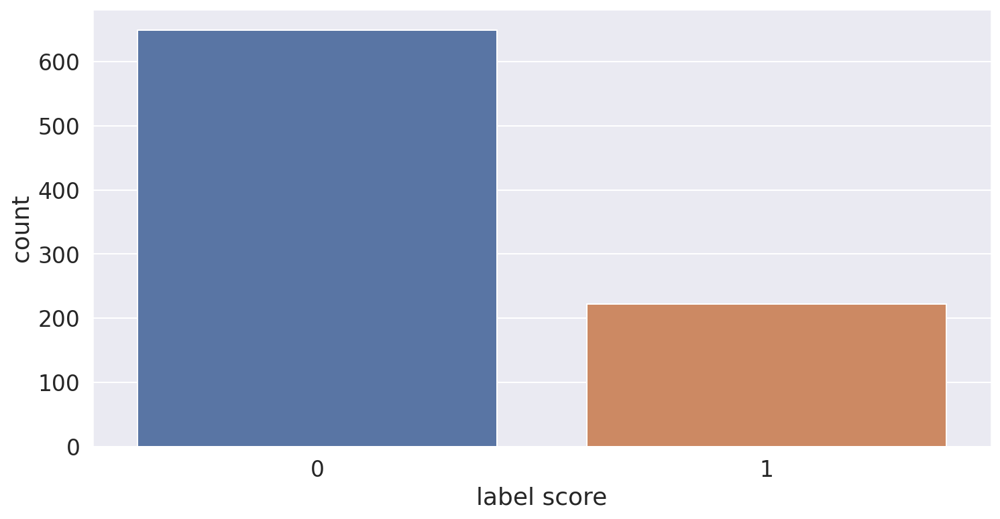

In [109]:
sns.countplot(train.label)
plt.xlabel('label score');

I did notice an imbalance in the labels of the dataset but since the size of the training data was small, resampling would've made the size of the dataset much smaller and would've not provided the expected results. 

In [17]:
# Get the lists of sentences and their labels.
abstract_train = train.abstract.values
labels_train = train.label.values

### Tokenization

BERT Tokenizer: 

To feed our text into the BERT model, it first needs to be tokenized ie. split into tokens and then these tokens must be mapped to their index in the tokenizer vocabulary

Here, i have used the "uncased" version

In [20]:
from transformers import BertTokenizer

# Load the BERT tokenizer.
print('Loading BERT tokenizer...')
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased', do_lower_case=True)

Loading BERT tokenizer...


Downloading:   0%|          | 0.00/226k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/28.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/570 [00:00<?, ?B/s]

When all the sentences are converted, we use the tokenize.encode function to handle both steps, rather than calling tokenize and convert_token_to_ids

Understanding how tokenization works

In [21]:
sample_row = train.iloc[20]
sample_txt = sample_row.abstract
sample_labels = sample_row['label']

tokens = tokenizer.tokenize(sample_txt)
token_ids = tokenizer.convert_tokens_to_ids(tokens)
print(f' Sentence: {sample_txt}')
print(f'   Tokens: {tokens}')
print(f'Token IDs: {token_ids}')

 Sentence: OBJECTIVES: Androgen ablation with luteinizing hormone-releasing hormone (LHRH) agonists, orchiectomy, or oral estrogens has significant untoward sexual side effects. We evaluated a combination of finasteride and flutamide as potency-sparing androgen ablative therapy (AAT) for advanced adenocarcinoma of the prostate. In addition, we evaluated whether finasteride provided additional intraprostatic androgen blockade to flutamide. METHODS: Twenty men with advanced prostate cancer were given flutamide, 250 mg orally three times daily. Serum prostate-specific antigen (PSA) values were measured weekly. At a nadir PSA value, finasteride, 5 mg orally every day, was added. PSA values were then measured weekly until a second nadir PSA value was achieved. Sexual function was evaluated at baseline, at the second nadir PSA value, and every 3 months thereafter. Testosterone, dihydrotestosterone (DHT), and dehydroepiandrostenedione (DHEA) levels were measured at baseline and at the first a

Using special Tokens
- [SEP] - marker for ending of a sentence
- [CLS] - we must add this token to the start of each sentence, so BERT knows we’re doing classification
- There is also a special token for padding:
- BERT understands tokens that were in the training set. Everything else can be encoded using the [UNK] (unknown) token:

In [22]:
print(tokenizer.sep_token, tokenizer.sep_token_id)
print(tokenizer.cls_token, tokenizer.cls_token_id)
print(tokenizer.pad_token, tokenizer.pad_token_id)
print(tokenizer.unk_token, tokenizer.unk_token_id)

[SEP] 102
[CLS] 101
[PAD] 0
[UNK] 100


In [23]:
encoding = tokenizer.encode_plus(
  sample_txt,
  max_length=512,
  add_special_tokens=True, # Add '[CLS]' and '[SEP]'
  return_token_type_ids=False,
  pad_to_max_length=True,
  return_attention_mask=True,
  return_tensors='pt',  # Return PyTorch tensors
)
encoding.keys()

Truncation was not explicitly activated but `max_length` is provided a specific value, please use `truncation=True` to explicitly truncate examples to max length. Defaulting to 'longest_first' truncation strategy. If you encode pairs of sequences (GLUE-style) with the tokenizer you can select this strategy more precisely by providing a specific strategy to `truncation`.
/usr/local/lib/python3.7/dist-packages/transformers/tokenization_utils_base.py:2269: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  FutureWarning,


dict_keys(['input_ids', 'attention_mask'])

In [24]:
encoding["input_ids"].shape, encoding["attention_mask"].shape

(torch.Size([1, 512]), torch.Size([1, 512]))

In [25]:
print(len(encoding['input_ids'][0]))
encoding['input_ids'][0]

512


tensor([  101, 11100,  1024,  1998, 22991, 11113, 13490,  2007, 11320,  9589,
         6026, 18714,  1011,  8287, 18714,  1006,  1048,  8093,  2232,  1007,
         3283, 26942,  2015,  1010,  2030,  5428, 22471, 16940,  1010,  2030,
         8700,  9765, 22991,  2015,  2038,  3278, 19662,  7652,  4424,  2217,
         3896,  1012,  2057, 16330,  1037,  5257,  1997, 10346, 24268,  5178,
         1998, 19857, 15464,  5178,  2004,  8962, 11916,  1011, 12403,  4892,
         1998, 22991, 11113, 26255,  7242,  1006,  9779,  2102,  1007,  2005,
         3935, 16298, 24755, 11890,  5740,  2863,  1997,  1996, 25086,  1012,
         1999,  2804,  1010,  2057, 16330,  3251, 10346, 24268,  5178,  3024,
         3176, 26721, 21572, 16677,  1998, 22991, 15823,  2000, 19857, 15464,
         5178,  1012,  4725,  1024,  3174,  2273,  2007,  3935, 25086,  4456,
         2020,  2445, 19857, 15464,  5178,  1010,  5539, 11460,  8700,  2135,
         2093,  2335,  3679,  1012, 20194, 25086,  1011,  3563, 

In [26]:
# Tokenize all of the sentences and map the tokens to thier word IDs.
input_ids = []

# For every sentence...
for abstract in abstract_train:
    # `encode` will:
    #   (1) Tokenize the sentence.
    #   (2) Prepend the `[CLS]` token to the start.
    #   (3) Append the `[SEP]` token to the end.
    #   (4) Map tokens to their IDs.
    encoded_sent = tokenizer.encode(
                        abstract,                      # Sentence to encode.
                        add_special_tokens = True, # Add '[CLS]' and '[SEP]'

                        
                        # max_length = 128,          # Truncate all sentences.
                        #return_tensors = 'pt',     # Return pytorch tensors.
                   )
    
    # Add the encoded sentence to the list.
    input_ids.append(encoded_sent)

# Test this with an example as a list of IDs.
print('Original: ', abstract_train[0])
print('Token IDs:', input_ids[0])

Token indices sequence length is longer than the specified maximum sequence length for this model (544 > 512). Running this sequence through the model will result in indexing errors


Original:  CONTEXT: We wanted to investigate vitamin D in low-risk prostate cancer. OBJECTIVES: The objective of the study was to determine whether vitamin D(3) supplementation at 4000 IU/d for 1 yr is safe and would result in a decrease in serum levels of prostate-specific antigen (PSA) or in the rate of progression. DESIGN: In this open-label clinical trial (Investigational New Drug 77,839), subjects were followed up until repeat biopsy. SETTING: All subjects were enrolled through the Medical University of South Carolina and the Ralph H. Johnson Veterans Affairs Medical Center, both in Charleston, SC. PATIENTS AND OTHER PARTICIPANTS: All subjects had a diagnosis of low-risk prostate cancer. Fifty-two subjects were enrolled in the study, 48 completed 1 yr of supplementation, and 44 could be analyzed for both safety and efficacy objectives. INTERVENTION: The intervention included vitamin D(3) soft gels (4000 IU). MAIN OUTCOME MEASURES: Adverse events were monitored throughout the study

### Padding and Truncating

In [27]:
print('Max sentence length: ', max([len(sen) for sen in input_ids]))

Max sentence length:  992


Text examples should be mostly less than 512 tokens. Longer texts will be cut from the end to fit the sequence length specified in the model block.

In [28]:
from keras.preprocessing.sequence import pad_sequences

# Set the maximum sequence length=512, although the len of some abstract texts are larger it is recommended to use 512 as the max length

MAX_LEN = 512

print('\nPadding/truncating all sentences to %d values...' % MAX_LEN)

print('\nPadding token: "{:}", ID: {:}'.format(tokenizer.pad_token, tokenizer.pad_token_id))

# Pad the input tokens with value 0.
# "post" indicates that we want to pad and truncate at the end of the sequence,
# as opposed to the beginning.
input_ids = pad_sequences(input_ids, maxlen=MAX_LEN, dtype="long", 
                          value=0, truncating="post", padding="post")

print('\nDone.')


Padding/truncating all sentences to 512 values...

Padding token: "[PAD]", ID: 0

Done.


### Creating Attention Masks

The attention makes should which tokens are padded and which are not ie. when a token ID = 0 in the BERT vocabulary then  its padding else its a real token

In [29]:
# Create attention masks
attention_masks = []

# For each sentence
for sent in input_ids:
    
    # Create the attention mask.
    #   - If a token ID is 0, then it's padding, set the mask to 0.
    #   - If a token ID is > 0, then it's a real token, set the mask to 1.
    att_mask = [int(token_id > 0) for token_id in sent]
    
    # Store the attention mask for this sentence.
    attention_masks.append(att_mask)

## Training and Validation Split

In [30]:
from sklearn.model_selection import train_test_split

# Use 90% for training and 10% for validation.
train_inputs, validation_inputs, train_labels, validation_labels = train_test_split(input_ids, labels_train, 
                                                            random_state=2018, test_size=0.1)
# Do the same for the masks.
train_masks, validation_masks, _, _ = train_test_split(attention_masks, labels_train,
                                             random_state=2018, test_size=0.1)

We need to convert the train and validation data which are numpy arrays into tensors suitable Pytorch data types

In [31]:
# Convert all inputs and labels into torch tensors, the required datatype for the model
train_inputs = torch.tensor(train_inputs)
validation_inputs = torch.tensor(validation_inputs)

train_labels = torch.tensor(train_labels)
validation_labels = torch.tensor(validation_labels)

train_masks = torch.tensor(train_masks)
validation_masks = torch.tensor(validation_masks)

In [32]:
#creating a torch DataLoader class. 
from torch.utils.data import TensorDataset, DataLoader, RandomSampler, SequentialSampler

# The DataLoader needs to know our batch size for training.

batch_size = 32

# Create the DataLoader for our training set.
train_data = TensorDataset(train_inputs, train_masks, train_labels)
train_sampler = RandomSampler(train_data)
train_dataloader = DataLoader(train_data, sampler=train_sampler, batch_size=batch_size)

# Create the DataLoader for our validation set.
validation_data = TensorDataset(validation_inputs, validation_masks, validation_labels)
validation_sampler = SequentialSampler(validation_data)
validation_dataloader = DataLoader(validation_data, sampler=validation_sampler, batch_size=batch_size)

### Training Classification Model

BertForSequenceClassification is used here: entire pre-trained BERT model and the additional untrained classification layer is trained on our specific task.

In [34]:
from transformers import BertForSequenceClassification, AdamW, BertConfig

# Load BertForSequenceClassification 
model = BertForSequenceClassification.from_pretrained(
    "bert-base-uncased", # Use the 12-layer BERT model, with an uncased vocab.
    num_labels = 2, # The number of output labels--2 for binary classification.  
    output_attentions = False, # Whether the model returns attentions weights.
    output_hidden_states = False, # Whether the model returns all hidden-states.
)


Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForSequenceClassification: ['cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.seq_relationship.bias', 'cls.predictions.bias', 'cls.predictions.decoder.weight']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at

In [35]:
# Get all of the model's parameters as a list of tuples.
params = list(model.named_parameters())

print('The BERT model has {:} different named parameters.\n'.format(len(params)))

print('==== Embedding Layer ====\n')

for p in params[0:5]:
    print("{:<55} {:>12}".format(p[0], str(tuple(p[1].size()))))

print('\n==== First Transformer ====\n')

for p in params[5:21]:
    print("{:<55} {:>12}".format(p[0], str(tuple(p[1].size()))))

print('\n==== Output Layer ====\n')

for p in params[-4:]:
    print("{:<55} {:>12}".format(p[0], str(tuple(p[1].size()))))

The BERT model has 201 different named parameters.

==== Embedding Layer ====

bert.embeddings.word_embeddings.weight                  (30522, 768)
bert.embeddings.position_embeddings.weight                (512, 768)
bert.embeddings.token_type_embeddings.weight                (2, 768)
bert.embeddings.LayerNorm.weight                              (768,)
bert.embeddings.LayerNorm.bias                                (768,)

==== First Transformer ====

bert.encoder.layer.0.attention.self.query.weight          (768, 768)
bert.encoder.layer.0.attention.self.query.bias                (768,)
bert.encoder.layer.0.attention.self.key.weight            (768, 768)
bert.encoder.layer.0.attention.self.key.bias                  (768,)
bert.encoder.layer.0.attention.self.value.weight          (768, 768)
bert.encoder.layer.0.attention.self.value.bias                (768,)
bert.encoder.layer.0.attention.output.dense.weight        (768, 768)
bert.encoder.layer.0.attention.output.dense.bias              (

In [36]:
# AdamW is a class from the huggingface library  
optimizer = AdamW(model.parameters(),
                  lr = 2e-5, # args.learning_rate - set 2e-5, 
                  eps = 1e-8 # args.adam_epsilon  
                )

/usr/local/lib/python3.7/dist-packages/transformers/optimization.py:309: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  FutureWarning,


In [60]:
from transformers import get_linear_schedule_with_warmup

# Number of training epochs 
epochs = 6

# Total number of training steps is number of batches * number of epochs.
total_steps = len(train_dataloader) * epochs

# Create the learning rate scheduler.
scheduler = get_linear_schedule_with_warmup(optimizer, 
                                            num_warmup_steps = 0, 
                                            num_training_steps = total_steps)
scheduler

### Training loop:

The training loop consists of the training and validation phase

In [61]:
import numpy as np

# Function to calculate the accuracy of our predictions vs labels
def flat_accuracy(preds, labels):
    pred_flat = np.argmax(preds, axis=1).flatten()
    labels_flat = labels.flatten()
    return np.sum(pred_flat == labels_flat) / len(labels_flat)

In [62]:
import time
import datetime

def format_time(elapsed):
    '''
    Takes a time in seconds and returns a string hh:mm:ss
    '''
    # Round to the nearest second.
    elapsed_rounded = int(round((elapsed)))
    
    # Format as hh:mm:ss
    return str(datetime.timedelta(seconds=elapsed_rounded))

In [63]:
import random


# Set the seed value all over the place to make this reproducible.
seed_val = 42

random.seed(seed_val)
np.random.seed(seed_val)
torch.manual_seed(seed_val)
torch.cuda.manual_seed_all(seed_val)

# Store the average loss after each epoch so we can plot them.
loss_values = []

# For each epoch...
for epoch_i in range(0, epochs):
    
    # ========================================
    #               Training
    # ========================================
    
    # Perform one full pass over the training set.

    print("")
    print('======== Epoch {:} / {:} ========'.format(epoch_i + 1, epochs))
    print('Training...')

    # Measure how long the training epoch takes.
    t0 = time.time()

    # Reset the total loss for this epoch.
    total_loss = 0

    # Put the model into training mode. 
    model.train()

    # For each batch of training data...
    for step, batch in enumerate(train_dataloader):

        # Progress update every 40 batches.
        if step % 40 == 0 and not step == 0:
            # Calculate elapsed time in minutes.
            elapsed = format_time(time.time() - t0)
            
            # Report progress.
            print('  Batch {:>5,}  of  {:>5,}.    Elapsed: {:}.'.format(step, len(train_dataloader), elapsed))

        # Unpack this training batch from our dataloader. 
        # `batch` contains three pytorch tensors:
        #   [0]: input ids 
        #   [1]: attention masks
        #   [2]: labels 
        b_input_ids = batch[0].to(device)
        b_input_mask = batch[1].to(device)
        b_labels = batch[2].to(device)

        model.zero_grad()        

        # Perform a forward pass (evaluate the model on this training batch).
        outputs = model(b_input_ids, 
                    token_type_ids=None, 
                    attention_mask=b_input_mask, 
                    labels=b_labels)
        
        # The call to `model` always returns a tuple, so we need to pull the 
        # loss value out of the tuple.
        loss = outputs[0]

        # Accumulate the training loss over all of the batches so that we can
        # calculate the average loss at the end. `loss` is a Tensor containing a
        # single value; the `.item()` function just returns the Python value 
        # from the tensor.
        total_loss += loss.item()

        # Perform a backward pass to calculate the gradients.
        loss.backward()

        # Clip the norm of the gradients to 1.0.
        # This is to help prevent the "exploding gradients" problem.
        torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)

        # Update parameters and take a step using the computed gradient.
        # The optimizer dictates the "update rule"--how the parameters are
        # modified based on their gradients, the learning rate, etc.
        optimizer.step()

        # Update the learning rate.
        scheduler.step()

    # Calculate the average loss over the training data.
    avg_train_loss = total_loss / len(train_dataloader)            
    
    # Store the loss value for plotting the learning curve.
    loss_values.append(avg_train_loss)

    print("")
    print("  Average training loss: {0:.2f}".format(avg_train_loss))
    print("  Training epoch took: {:}".format(format_time(time.time() - t0)))
        
    # ========================================
    #               Validation
    # ========================================
    # After the completion of each training epoch, measure our performance on
    # our validation set.

    print("")
    print("Running Validation...")

    t0 = time.time()

    # Put the model in evaluation mode--the dropout layers behave differently
    # during evaluation.
    model.eval()

    # Tracking variables 
    eval_loss, eval_accuracy = 0, 0
    nb_eval_steps, nb_eval_examples = 0, 0

    # Evaluate data for one epoch
    for batch in validation_dataloader:
        
        # Add batch to GPU
        batch = tuple(t.to(device) for t in batch)
        
        # Unpack the inputs from our dataloader
        b_input_ids, b_input_mask, b_labels = batch
        
        # Telling the model not to compute or store gradients, saving memory and
        # speeding up validation
        with torch.no_grad():        

            # Forward pass, calculate logit predictions.
            # This will return the logits rather than the loss because we have
            # not provided labels.
            outputs = model(b_input_ids, 
                            token_type_ids=None, 
                            attention_mask=b_input_mask)
        
        # Get the "logits" output by the model. The "logits" are the output
        # values prior to applying an activation function like the softmax.
        logits = outputs[0]

        # Move logits and labels to CPU
        logits = logits.detach().cpu().numpy()
        label_ids = b_labels.to('cpu').numpy()
        
        # Calculate the accuracy for this batch of test sentences.
        tmp_eval_accuracy = flat_accuracy(logits, label_ids)
        
        # Accumulate the total accuracy.
        eval_accuracy += tmp_eval_accuracy

        # Track the number of batches
        nb_eval_steps += 1

    # Report the final accuracy for this validation run.
    print("  Accuracy: {0:.2f}".format(eval_accuracy/nb_eval_steps))
    print("  Validation took: {:}".format(format_time(time.time() - t0)))

print("")
print("Training complete!")


======== Epoch 1 / 6 ========
Training...

  Average training loss: 0.27
  Training epoch took: 0:07:38

Running Validation...
  Accuracy: 0.85
  Validation took: 0:00:17

======== Epoch 2 / 6 ========
Training...

  Average training loss: 0.19
  Training epoch took: 0:08:00

Running Validation...
  Accuracy: 0.84
  Validation took: 0:00:12

======== Epoch 3 / 6 ========
Training...

  Average training loss: 0.10
  Training epoch took: 0:05:54

Running Validation...
  Accuracy: 0.79
  Validation took: 0:00:12

======== Epoch 4 / 6 ========
Training...

  Average training loss: 0.06
  Training epoch took: 0:05:53

Running Validation...
  Accuracy: 0.81
  Validation took: 0:00:12

======== Epoch 5 / 6 ========
Training...

  Average training loss: 0.05
  Training epoch took: 0:05:55

Running Validation...
  Accuracy: 0.80
  Validation took: 0:00:12

======== Epoch 6 / 6 ========
Training...

  Average training loss: 0.04
  Training epoch took: 0:05:52

Running Validation...
  Accuracy: 

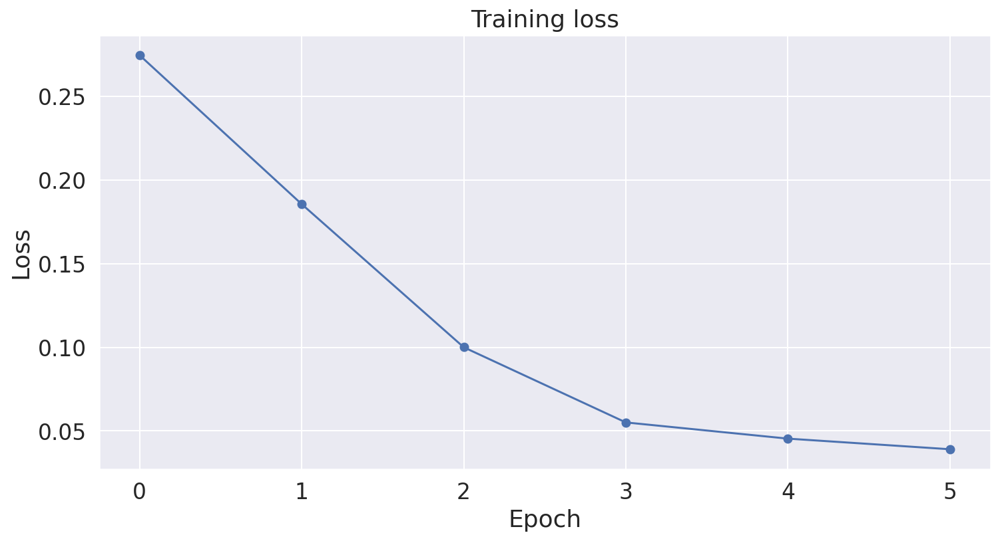

In [65]:
import matplotlib.pyplot as plt
#% matplotlib inline

import seaborn as sns

sns.set(style='darkgrid')

sns.set(font_scale=1.5)
plt.rcParams["figure.figsize"] = (12,6)

# Plot the learning curve.
plt.plot(loss_values, 'b-o')

# Label the plot.
plt.title("Training loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")

plt.show()

In [66]:
loss_values

[0.274649566411972,
 0.18563294440507888,
 0.10003455571830272,
 0.05510002709925175,
 0.04541755370795727,
 0.039068931080400944]

## Evaluation

In [67]:
test = pd.read_excel("/content/Rebootrx_ML_test_2022.xlsx",sheet_name=1)

In [68]:
test

,pmid,drug,title,abstract,label
0,27068390,Corticotropin,Small cell carcinoma of the prostate presentin...,Small cell carcinoma (SCC) of the prostate is ...,LabelA
1,26768648,Choline,Serial 18F-choline-PET imaging in patients rec...,AIM: High rate of non-target lesions in metast...,LabelA
2,17070238,finasteride,Prostate cancer prevention and finasteride.,PURPOSE: We assessed whether the association b...,LabelA
3,34601492,Metformin,Prostate cancer genetic propensity risk score ...,BACKGROUND: Some studies have reported an inve...,LabelA
4,21197325,Meloxicam,Characterization of a rat model of metastatic ...,PURPOSE: The objectives of this study were to ...,LabelA
...,...,...,...,...,...
195,23918942,Metformin,Metformin use and all-cause and prostate cance...,PURPOSE: To evaluate the association between c...,LabelB
196,29245991,Metformin,The impact of metformin use on survival in pro...,Background: Metformin has been implicated to r...,LabelB
197,32588515,Celecoxib,Biochemical control of the combination of cycl...,OBJECTIVES: To evaluate the use of cyclooxygen...,LabelB
198,8558676,Allopurinol,5-fluorouracil and allopurinol combined with r...,PURPOSE: We determined the toxicity and prelim...,LabelB


In [69]:
class_names = ['LabelA','LabelB']

In [70]:
test.isna().sum()

pmid        0
drug        0
title       0
abstract    0
label       0
dtype: int64

In [71]:
test = test.drop(columns = ['pmid', 'drug' , 'title'], axis = 1)

In [72]:
test

,abstract,label
0,Small cell carcinoma (SCC) of the prostate is ...,LabelA
1,AIM: High rate of non-target lesions in metast...,LabelA
2,PURPOSE: We assessed whether the association b...,LabelA
3,BACKGROUND: Some studies have reported an inve...,LabelA
4,PURPOSE: The objectives of this study were to ...,LabelA
...,...,...
195,PURPOSE: To evaluate the association between c...,LabelB
196,Background: Metformin has been implicated to r...,LabelB
197,OBJECTIVES: To evaluate the use of cyclooxygen...,LabelB
198,PURPOSE: We determined the toxicity and prelim...,LabelB


In [73]:
test = test.replace(cat_numeric)
test

,abstract,label
0,Small cell carcinoma (SCC) of the prostate is ...,0
1,AIM: High rate of non-target lesions in metast...,0
2,PURPOSE: We assessed whether the association b...,0
3,BACKGROUND: Some studies have reported an inve...,0
4,PURPOSE: The objectives of this study were to ...,0
...,...,...
195,PURPOSE: To evaluate the association between c...,1
196,Background: Metformin has been implicated to r...,1
197,OBJECTIVES: To evaluate the use of cyclooxygen...,1
198,PURPOSE: We determined the toxicity and prelim...,1


In [74]:
# Get the lists of sentences and their labels.
abstract_test = test.abstract.values
labels_test = test.label.values

# Report the number of sentences.
print('Number of test sentences: {:,}\n'.format(test.shape[0]))

Number of test sentences: 200



In [75]:
# Tokenize all of the sentences and map the tokens to thier word IDs.
input_ids = []

for abstract in abstract_test:
    #   (1) Tokenize the sentence.
    #   (2) Prepend the `[CLS]` token to the start.
    #   (3) Append the `[SEP]` token to the end.
    #   (4) Map tokens to their IDs.
    encoded_sent = tokenizer.encode(
                        abstract,                      # Sentence to encode.
                        add_special_tokens = True, # Add '[CLS]' and '[SEP]'
                   )
    
    input_ids.append(encoded_sent)

# Pad input tokens
input_ids = pad_sequences(input_ids, maxlen=MAX_LEN, 
                          dtype="long", truncating="post", padding="post")

# Create attention masks
attention_masks = []

# Create a mask of 1s for each token followed by 0s for padding
for seq in input_ids:
  seq_mask = [float(i>0) for i in seq]
  attention_masks.append(seq_mask) 

# Convert to tensors.
prediction_inputs = torch.tensor(input_ids)
prediction_masks = torch.tensor(attention_masks)
prediction_labels = torch.tensor(labels_test)

# Set the batch size.  
batch_size = 32  

# Create the DataLoader.
prediction_data = TensorDataset(prediction_inputs, prediction_masks, prediction_labels)
prediction_sampler = SequentialSampler(prediction_data)
prediction_dataloader = DataLoader(prediction_data, sampler=prediction_sampler, batch_size=batch_size)

### Evaluate on Test Set

In [76]:

print('Predicting labels for {:,} test sentences...'.format(len(prediction_inputs)))

# Put model in evaluation mode
model.eval()

# Tracking variables 
predictions , true_labels = [], []

# Predict 
for batch in prediction_dataloader:
  # Add batch to GPU
  batch = tuple(t.to(device) for t in batch)
  
  # Unpack the inputs from our dataloader
  b_input_ids, b_input_mask, b_labels = batch
  with torch.no_grad():
      # Forward pass, calculate logit predictions
      outputs = model(b_input_ids, token_type_ids=None, 
                      attention_mask=b_input_mask)

  logits = outputs[0]

  # Move logits and labels to CPU
  logits = logits.detach().cpu().numpy()
  label_ids = b_labels.to('cpu').numpy()
  
  # Store predictions and true labels
  predictions.append(logits)
  true_labels.append(label_ids)

print('DONE.')

Predicting labels for 200 test sentences...
DONE.


In [105]:
# Combine the predictions for each batch into a single list of 0s and 1s.
flat_predictions = [item for sublist in predictions for item in sublist]
flat_predictions = np.argmax(flat_predictions, axis=1).flatten()

# Combine the correct labels for each batch into a single list.
flat_true_labels = [item for sublist in true_labels for item in sublist]

In [79]:
#from the dataset
print('Positive samples: %d of %d (%.2f%%)' % (test.label.sum(), len(test.label), (test.label.sum() / len(test.label) * 100.0)))

Positive samples: 100 of 200 (50.00%)


In [108]:
#from the predictions
print('Positive samples predicted: %d of %d (%.2f%%)' % (flat_predictions.sum(), len(flat_predictions), (flat_predictions.sum() / len(flat_predictions) * 100.0)))

Positive samples predicted: 79 of 200 (39.50%)


### Evaluation Metrics

In [97]:
print(classification_report(flat_true_labels, flat_predictions, target_names=class_names))

              precision    recall  f1-score   support

      LabelA       0.72      0.87      0.79       100
      LabelB       0.84      0.66      0.74       100

    accuracy                           0.77       200
   macro avg       0.78      0.77      0.76       200
weighted avg       0.78      0.77      0.76       200



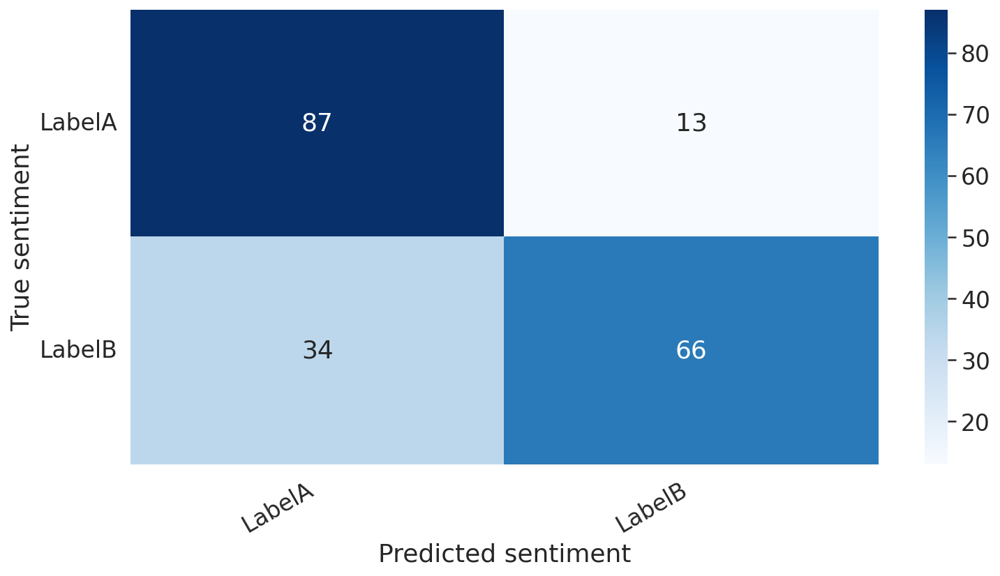

In [82]:
def show_confusion_matrix(confusion_matrix):
  hmap = sns.heatmap(confusion_matrix, annot=True, fmt="d", cmap="Blues")
  hmap.yaxis.set_ticklabels(hmap.yaxis.get_ticklabels(), rotation=0, ha='right')
  hmap.xaxis.set_ticklabels(hmap.xaxis.get_ticklabels(), rotation=30, ha='right')
  plt.ylabel('True sentiment')
  plt.xlabel('Predicted sentiment');
cm = confusion_matrix(flat_true_labels, flat_predictions)
df_cm = pd.DataFrame(cm, index=class_names, columns=class_names)
show_confusion_matrix(df_cm)

## Visualization of the test data using BertViz

In [83]:
def call_html():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              "d3": "https://cdnjs.cloudflare.com/ajax/libs/d3/3.5.8/d3.min",
              jquery: '//ajax.googleapis.com/ajax/libs/jquery/2.0.0/jquery.min',
            },
          });
        </script>
        '''))

I couldnt visualize the whole abstract text due to the size constraint, hence I took only a part of the abstract text data to visualize it using BertViz

In [90]:
model_version = 'bert-base-uncased'
do_lower_case = True
model = BertModel.from_pretrained(model_version, output_attentions=True)
tokenizer = BertTokenizer.from_pretrained(model_version, do_lower_case=do_lower_case)

#test.iloc[0]
sample_b = "CONCLUSION: Our findings suggest that FCH-PET/CT may play a role in defining prognosis of patients receiving enzalutamide because baseline SUVmax proved to be an independent prognostic factor."
inputs = tokenizer.encode_plus(sample_b, return_tensors='pt', add_special_tokens=True)
token_type_ids = inputs['token_type_ids']
input_ids = inputs['input_ids']
attention = model(input_ids, token_type_ids=token_type_ids)[-1]
input_id_list = input_ids[0].tolist() # Batch index 0
tokens = tokenizer.convert_ids_to_tokens(input_id_list)
call_html()

head_view(attention, tokens)

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.seq_relationship.bias', 'cls.predictions.bias', 'cls.predictions.decoder.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


<IPython.core.display.Javascript object>

In [100]:
model_view(attention, tokens)

<IPython.core.display.Javascript object>

Saving the Fine Tuned Model

In [91]:
import os

output_dir = './model_save/'

# Create output directory if needed
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

print("Saving model to %s" % output_dir)

# Save a trained model, configuration and tokenizer using `save_pretrained()`.
model_to_save = model.module if hasattr(model, 'module') else model  
model_to_save.save_pretrained(output_dir)
tokenizer.save_pretrained(output_dir)


Saving model to ./model_save/


('./model_save/tokenizer_config.json',
 './model_save/special_tokens_map.json',
 './model_save/vocab.txt',
 './model_save/added_tokens.json')

In [92]:
!ls -l --block-size=K ./model_save/

total 427976K
-rw-r--r-- 1 root root      1K Apr  7 21:38 config.json
-rw-r--r-- 1 root root 427731K Apr  7 21:38 pytorch_model.bin
-rw-r--r-- 1 root root      1K Apr  7 21:38 special_tokens_map.json
-rw-r--r-- 1 root root      1K Apr  7 21:38 tokenizer_config.json
-rw-r--r-- 1 root root    227K Apr  7 21:38 vocab.txt


In [94]:
!cp -r ./model_save/ "/content/BERT_RebootRx"

## Conclusion

From this classification using pre-trained BERT classifier, the test accuracy is 78% with a precision of 72% and f1 score of 79%. The model was able to identify 79 labels with LabelB out of the 200 samples of data

The performance of the model could be increased if the size of the dataset was larger

## References

https://huggingface.co/transformers/v2.2.0/model_doc/bert.html#transformers.BertForSequenceClassification

https://github.com/jessevig/bertviz

https://github.com/huggingface/transformers/blob/5bfcd0485ece086ebcbed2d008813037968a9e58/examples/run_glue.py#L128